In [1]:
import pandas as pd
import numpy as np

In [2]:
absent = pd.read_csv('Absenteeism_at_work.csv')
absent

,ID,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,...,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,11,26,7,3,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,4
1,36,0,7,3,1,118,13,18,50,239.554,...,1,1,1,1,0,0,98,178,31,0
2,3,23,7,4,1,179,51,18,38,239.554,...,0,1,0,1,0,0,89,170,31,2
3,7,7,7,5,1,279,5,14,39,239.554,...,0,1,2,1,1,0,68,168,24,4
4,11,23,7,5,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
735,11,14,7,3,1,289,36,13,33,264.604,...,0,1,2,1,0,1,90,172,30,8
736,1,11,7,3,1,235,11,14,37,264.604,...,0,3,1,0,0,1,88,172,29,4
737,4,0,0,3,1,118,14,13,40,271.219,...,0,1,1,1,0,8,98,170,34,0
738,8,0,0,4,2,231,35,14,39,271.219,...,0,1,2,1,0,2,100,170,35,0


## Data exploration

Before we do any modelling with the data it is important that we have a look at the data and see what it is telling us.

In [3]:
from pandas_profiling import ProfileReport

In [4]:
profile = ProfileReport(absent, title="Absenteeism Profiling Report")
profile

From the pandas profiling report we are picking up a few intersting factors about the employees:
1. Data contains 740 entries of 36 employees.
2. We have 21 features for the 740 entries.
3. We have 28 reasons for their absenteeism.
4. The month with most absenteeism is March.
5. On average the people who are absent stay about 30km from work.
6. 28 year olds and 38 year olds are the most absent.
7. Most of the absent people are smokers and drinkers.

## Data Wrangling

It is important to see if we have any duplicated data, or any nulls. So I will check for it below:

In [5]:
absent.isnull().values.any()

False

There are no entries, containing any NaN. This means the data is pretty clean for me to start modelling with it. But before I do, let me check for any duplicates that could skew the data.

In [6]:
absent = absent.drop_duplicates()
absent

,ID,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,...,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,11,26,7,3,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,4
1,36,0,7,3,1,118,13,18,50,239.554,...,1,1,1,1,0,0,98,178,31,0
2,3,23,7,4,1,179,51,18,38,239.554,...,0,1,0,1,0,0,89,170,31,2
3,7,7,7,5,1,279,5,14,39,239.554,...,0,1,2,1,1,0,68,168,24,4
4,11,23,7,5,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
735,11,14,7,3,1,289,36,13,33,264.604,...,0,1,2,1,0,1,90,172,30,8
736,1,11,7,3,1,235,11,14,37,264.604,...,0,3,1,0,0,1,88,172,29,4
737,4,0,0,3,1,118,14,13,40,271.219,...,0,1,1,1,0,8,98,170,34,0
738,8,0,0,4,2,231,35,14,39,271.219,...,0,1,2,1,0,2,100,170,35,0


The initial dataframe had 740 datapoints which contained duplicates. After getting rid of duplicates the dataframe contains 706 datapoints. I can now start with my modelling.

We will be treating each datapoint as an entry, considering that every absenteeism is unique, even if it is from the same employee.

## Problem Definition

Can we use the data given by our absent employees, to find a way to support them, thus reducing the the overall absenteeism.

In order for us to be able to support them, we will need to find out what are the combination factors that contribute to the absenteeism.

## Solution

Use an unsuppervised approach known as HDBSCAN to find out what strategic support we can use to assist our employees.

Before we can do any modelling, it is very important that we scale our data. Machine learning algorithms just sees number. The goal of normalization is to change the values of numeric columns in the dataset to a common scale, without distorting differences in the ranges of values.

In [7]:
from sklearn.preprocessing import StandardScaler
import seaborn as sns
from ivis import Ivis
import hdbscan
from numpy import save
from tqdm import tqdm
import matplotlib.pyplot as plt
import gc

In [8]:
scaler = StandardScaler()
absent_copy = absent.copy()
absent_copy = absent_copy.drop(['ID'], axis = 1)
absent_norm = scaler.fit_transform(absent_copy)
absent_norm = pd.DataFrame(absent_norm, columns=absent_copy.columns)
absent_norm

,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,Hit target,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,0.839646,0.173182,-0.625440,-1.382645,0.981812,0.456072,0.115466,-0.530399,-0.825141,0.645025,-0.245072,-0.434835,0.850679,0.877168,-0.287788,0.173279,0.855365,-0.032906,0.791184,-0.231133
1,-2.227525,0.173182,-0.625440,-1.382645,-1.561100,-1.108954,1.260392,2.061557,-0.825141,0.645025,4.080441,-0.434835,-0.055172,0.877168,-0.287788,-0.577243,1.477769,0.941840,1.026373,-0.525284
2,0.485741,0.173182,0.076564,-1.382645,-0.653979,1.476741,1.260392,0.231941,-0.825141,0.645025,-0.245072,-0.434835,-0.961024,0.877168,-0.287788,-0.577243,0.777564,-0.357821,1.026373,-0.378208
3,-1.401748,0.173182,0.778568,-1.382645,0.833103,-1.653311,0.344451,0.384409,-0.825141,0.645025,-0.245072,-0.434835,0.850679,0.877168,3.474777,-0.577243,-0.856246,-0.682736,-0.619955,-0.231133
4,0.485741,0.173182,0.778568,-1.382645,0.981812,0.456072,0.115466,-0.530399,-0.825141,0.645025,-0.245072,-0.434835,0.850679,0.877168,-0.287788,0.173279,0.855365,-0.032906,0.791184,-0.378208
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
701,-0.575972,0.173182,-0.625440,-1.382645,0.981812,0.456072,0.115466,-0.530399,-0.189851,-0.407286,-0.245072,-0.434835,0.850679,0.877168,-0.287788,0.173279,0.855365,-0.032906,0.791184,0.063017
702,-0.929876,0.173182,-0.625440,-1.382645,0.178787,-1.245043,0.344451,0.079473,-0.189851,-0.407286,-0.245072,2.545686,-0.055172,-1.140033,-0.287788,0.173279,0.699764,-0.032906,0.555994,-0.231133
703,-2.227525,-1.884190,-0.625440,-1.382645,-1.561100,-1.040909,0.115466,0.536877,-0.022089,0.118869,-0.245072,-0.434835,-0.055172,0.877168,-0.287788,5.426931,1.477769,-0.357821,1.731943,-0.525284
704,-2.227525,-1.884190,0.076564,-0.490371,0.119304,0.388028,0.344451,0.384409,-0.022089,0.118869,-0.245072,-0.434835,0.850679,0.877168,-0.287788,0.923801,1.633370,-0.357821,1.967132,-0.525284


<AxesSubplot:>

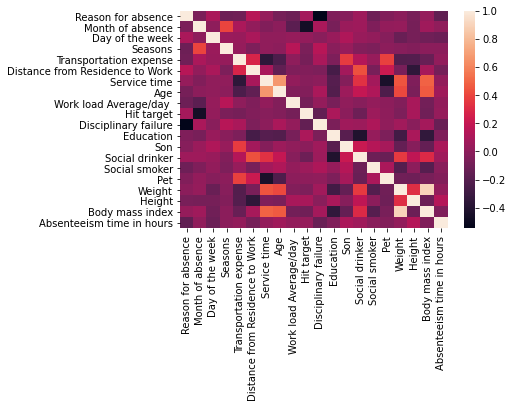

In [9]:
corr = absent_norm.corr()
sns.heatmap(corr)

In [10]:
columns = np.full((corr.shape[0],), True, dtype=bool)
for i in range(corr.shape[0]):
    for j in range(i+1, corr.shape[0]):
        if corr.iloc[i,j] >= 0.9:
            if columns[j]:
                columns[j] = False
selected_columns = absent_norm.columns[columns]
absent_norm = absent_norm[selected_columns]

In [11]:
absent_norm

,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,Hit target,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,0.839646,0.173182,-0.625440,-1.382645,0.981812,0.456072,0.115466,-0.530399,-0.825141,0.645025,-0.245072,-0.434835,0.850679,0.877168,-0.287788,0.173279,0.855365,-0.032906,0.791184,-0.231133
1,-2.227525,0.173182,-0.625440,-1.382645,-1.561100,-1.108954,1.260392,2.061557,-0.825141,0.645025,4.080441,-0.434835,-0.055172,0.877168,-0.287788,-0.577243,1.477769,0.941840,1.026373,-0.525284
2,0.485741,0.173182,0.076564,-1.382645,-0.653979,1.476741,1.260392,0.231941,-0.825141,0.645025,-0.245072,-0.434835,-0.961024,0.877168,-0.287788,-0.577243,0.777564,-0.357821,1.026373,-0.378208
3,-1.401748,0.173182,0.778568,-1.382645,0.833103,-1.653311,0.344451,0.384409,-0.825141,0.645025,-0.245072,-0.434835,0.850679,0.877168,3.474777,-0.577243,-0.856246,-0.682736,-0.619955,-0.231133
4,0.485741,0.173182,0.778568,-1.382645,0.981812,0.456072,0.115466,-0.530399,-0.825141,0.645025,-0.245072,-0.434835,0.850679,0.877168,-0.287788,0.173279,0.855365,-0.032906,0.791184,-0.378208
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
701,-0.575972,0.173182,-0.625440,-1.382645,0.981812,0.456072,0.115466,-0.530399,-0.189851,-0.407286,-0.245072,-0.434835,0.850679,0.877168,-0.287788,0.173279,0.855365,-0.032906,0.791184,0.063017
702,-0.929876,0.173182,-0.625440,-1.382645,0.178787,-1.245043,0.344451,0.079473,-0.189851,-0.407286,-0.245072,2.545686,-0.055172,-1.140033,-0.287788,0.173279,0.699764,-0.032906,0.555994,-0.231133
703,-2.227525,-1.884190,-0.625440,-1.382645,-1.561100,-1.040909,0.115466,0.536877,-0.022089,0.118869,-0.245072,-0.434835,-0.055172,0.877168,-0.287788,5.426931,1.477769,-0.357821,1.731943,-0.525284
704,-2.227525,-1.884190,0.076564,-0.490371,0.119304,0.388028,0.344451,0.384409,-0.022089,0.118869,-0.245072,-0.434835,0.850679,0.877168,-0.287788,0.923801,1.633370,-0.357821,1.967132,-0.525284


In [12]:
absent_norm_values = absent_norm.values
type(absent_norm_values)

numpy.ndarray

In [13]:
absent_norm_values

array([[ 0.8396455 ,  0.17318229, -0.62543981, ..., -0.03290573,
         0.79118362, -0.23113317],
       [-2.22752522,  0.17318229, -0.62543981, ...,  0.94184018,
         1.02637336, -0.52528371],
       [ 0.48574119,  0.17318229,  0.07656417, ..., -0.35782103,
         1.02637336, -0.37820844],
       ...,
       [-2.22752522, -1.88418996, -0.62543981, ..., -0.35782103,
         1.73194259, -0.52528371],
       [-2.22752522, -1.88418996,  0.07656417, ..., -0.35782103,
         1.96713233, -0.52528371],
       [-2.22752522, -1.88418996,  1.48057214, ...,  0.45446723,
        -0.38476509, -0.52528371]])

In [39]:
# viz
viz_model = Ivis(embedding_dims=2, k=10, n_epochs_without_progress=3, model='maaten')
viz_embeddings = viz_model.fit_transform(absent_norm_values)

#clustering
clust_model = Ivis(embedding_dims=2, k=6, n_epochs_without_progress=3, model='maaten')
clust_embeddings = clust_model.fit_transform(absent_norm_values)

100%|██████████| 706/706 [00:00<00:00, 147212.46it/s]

Building KNN index
Extracting KNN from index



100%|██████████| 706/706 [00:00<00:00, 3623.79it/s]


Training neural network
Epoch 1/1000
6/6 [==============================] - 0s 48ms/step - loss: 0.7531
Epoch 2/1000
6/6 [==============================] - 0s 51ms/step - loss: 0.6298
Epoch 3/1000
6/6 [==============================] - 0s 48ms/step - loss: 0.5580
Epoch 4/1000
6/6 [==============================] - 0s 50ms/step - loss: 0.6005
Epoch 5/1000
6/6 [==============================] - 0s 46ms/step - loss: 0.8456
Epoch 6/1000
23/23 [==============================] - 0s 4ms/step


100%|██████████| 706/706 [00:00<00:00, 208989.95it/s]

Building KNN index
Extracting KNN from index



100%|██████████| 706/706 [00:00<00:00, 4111.06it/s]


Training neural network
Epoch 1/1000
6/6 [==============================] - 0s 44ms/step - loss: 0.6077
Epoch 2/1000
6/6 [==============================] - 0s 49ms/step - loss: 0.5020
Epoch 3/1000
6/6 [==============================] - 0s 49ms/step - loss: 0.4082
Epoch 4/1000
6/6 [==============================] - 0s 64ms/step - loss: 0.6327
Epoch 5/1000
6/6 [==============================] - 0s 51ms/step - loss: 0.5794
Epoch 6/1000
23/23 [==============================] - 0s 4ms/step


In [40]:
# save('viz_embeddings.npy', viz_embeddings)
# save('clust_embeddings.npy', clust_embeddings)

In [41]:
viz = viz_embeddings
clus = clust_embeddings

In [42]:
np.random.seed(3)
clusterer = hdbscan.HDBSCAN(min_cluster_size=45, min_samples=5, prediction_data=True, alpha=1.3).fit(clus)
 
 
soft_clusters = hdbscan.all_points_membership_vectors(clusterer)
color_palette = sns.color_palette('tab20', np.unique(clusterer.labels_).shape[0])
 
cluster_colors = [color_palette[np.argmax(x)]
                  for x in tqdm(soft_clusters)]

100%|██████████| 706/706 [00:00<00:00, 111105.31it/s]


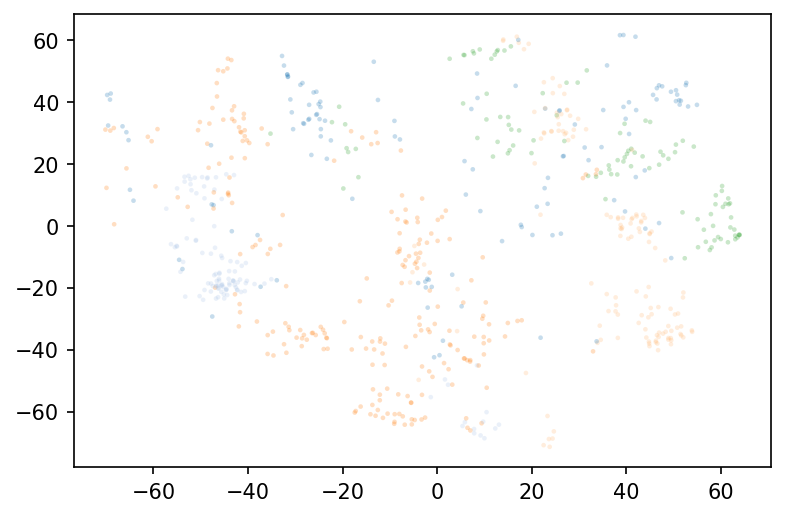

In [43]:
np.random.seed(3)
fig = plt.figure(dpi=150)
plt.scatter(viz_embeddings[:,0],
            viz_embeddings[:,1], s=5, linewidth=0, c=cluster_colors, alpha=0.25)
plt.show()

In [44]:
# absent = absent.set_index(['ID'])

In [45]:
clusterer.labels_.max()

4

## Analysing results

We see that using minimum cluster size of 45, we are able to get 4 clusters. We now need to evalute these clusters and see what makes them unique.

In [ ]:
def exemplars(cluster_id, condensed_tree):
    raw_tree = condensed_tree._raw_tree
    # Just the cluster elements of the tree, excluding singleton points
    cluster_tree = raw_tree[raw_tree['child_size'] > 1]
    # Get the leaf cluster nodes under the cluster we are considering
    leaves = hdbscan.plots._recurse_leaf_dfs(cluster_tree, cluster_id)
    # Now collect up the last remaining points of each leaf cluster (the heart of the leaf)
    result = np.array([])
    for leaf in leaves:
        max_lambda = raw_tree['lambda_val'][raw_tree['parent'] == leaf].max()
        points = raw_tree['child'][(raw_tree['parent'] == leaf) &
                                   (raw_tree['lambda_val'] == max_lambda)]
        result = np.hstack((result, points))
    return result.astype(np.int)

In [ ]:
# getting which members best describe the cluster for each cluster
tree = clusterer.condensed_tree_
people = []
for i, c in enumerate(tree._select_clusters()):
    c_exemplars = exemplars(c, tree)
    people = people + c_exemplars.tolist()
absent['main_people'] = 0
for p in people:
    absent.loc[absent.index == p,['main_people']]= 1

In [ ]:
data_c = pd.DataFrame(clust_embeddings)
data_c

In [ ]:
data_c.columns = ['dim' + str(col) for col in data_c.columns]
data_c

In [ ]:
y = hdbscan.membership_vector(clusterer,data_c[[t for t in data_c.columns.values if "dim" in t]].values)
labels = [np.argmax(x) for x in y]
data_c['cluster'] = labels
# data_c['probs'] =[x for x in y]

In [ ]:
# Getting which members belong to what cluster and appending to the DataFrame
labels,strength = hdbscan.approximate_predict(clusterer,data_c[[t for t in data_c.columns.values if "dim" in t]])
data_c['Cs'] =  labels
#del y,label,people,c_exemplars,people
gc.collect()
gc.collect()

In [ ]:
reindex_data = absent.reset_index()
reindex_data

In [ ]:
cluster_absent = reindex_data.merge(data_c, left_index=True, right_index=True)
cluster_absent = cluster_absent.replace(np.nan, -1)
cluster_absent

In [ ]:
final_results = cluster_absent[['Reason for absence', 'Month of absence', 'Day of the week',
       'Seasons', 'Transportation expense', 'Distance from Residence to Work',
       'Service time', 'Age', 'Work load Average/day ', 'Hit target',
       'Disciplinary failure', 'Education', 'Son', 'Social drinker',
       'Social smoker', 'Pet', 'Weight', 'Height', 'Body mass index',
       'Absenteeism time in hours', 'main_people','cluster']]
final_results

In [ ]:
knn_features = final_results[final_results.columns].groupby('cluster').describe().T.drop_duplicates(keep='last').copy()
knn_features.index = ["_".join(v) for v in knn_features.index]

In [ ]:
knn_features = knn_features.T
knn_features.head()

In [ ]:
knn_features.to_csv('cluster_stats_absenteeism.csv')

In [ ]:
final_results